---
title: Transforming workflow for oceanography study using Sentinel‑2 data, from SAFE to Zarr
subtitle: Computing wave spectra with 2D FFT & coherence in the EOPF framework

authors:
  - name: Tina Odaka
    orcid: 0000-0002-1500-0156
    github: tinaok
    affiliations:
      - id: IFREMER
        institution: IFREMER
        ror: 044jxhp58
  - name: Nicolas Rascle
    orcid: 0000-0001-9959-1119
    github: nrascle
    affiliations:
      - id: IFREMER
        institution: IFREMER
        ror: 044jxhp58
  - name: Anne Fouilloux
    orcid: 0000-0002-1784-2920
    github: annefou
    affiliations:
      - id: Simula Research Laboratory
        institution: Simula Research Laboratory
        ror: 00vn06n10
date: 2025-07-29
thumbnail: https://raw.githubusercontent.com/EOPF-Sample-Service/eopf-sample-notebooks/refs/heads/main/notebooks/static/ESA_logo_2020_Deep.png
keywords: ["oceanography", "wave analysis", "remote sensing"]
tags: ["oceanography", "spectral analysis", "Sentinel-2"]
releaseDate: 2025-07-29
datePublished: 2025-07-29
dateModified: 2025-08-23
github: https://github.com/EOPF-Sample-Service/eopf-sample-notebooks
license: Apache-2.0
---

```{image} ../static/ESA_EOPF_logo_2025_COLOR_ESA_blue_reduced.png
:alt: ESA EOPF Zarr Logo
:width: 250px
:align: center
```

## Table of contents

- [Introduction](#Introduction)
- [Setup](#Setup)
- [Accessing Sentinel-2 Data in EOPF Zarr Format](#Read)
- [Selecting a Region and Verifying Detector Consistency](#Select)
- [Image Normalization and Whitecap Filtering](#Filtering)
- [Fourier Transform & Welch-Based Spectral Analysis](#Welch)
- [🌊 Fourier and Cross-Spectral Analysis with angular metrics](#Cross)
- [Summary](#Summary)


## Introduction

This notebook demonstrates an improved workflow for oceanographic wave spectral analysis using Sentinel-2 data. We transition from the traditional SAFE format to the cloud-optimized EOPF Zarr format, highlighting substantial improvements in computational efficiency, simplicity, and scalability.

Original research workflow based on SAFE format is available at [this notebook](https://github.com/tinaok/eopf-webiner6/blob/main/SAFE_workflow.ipynb).

To understand the scientific background for the wave analysis methods used here, refer to:
[Kudryavtsev et al., 2016](https://agupubs.onlinelibrary.wiley.com/doi/full/10.1002/2016JC012425).

This workflow leverages the new EOPF Zarr format, eliminating the cumbersome steps required for loading SAFE files, significantly simplifying data handling and computational processing.



:::{hint} Overview
**Questions**
- How can we perform wave spectral analysis using Sentinel-2 data in the EOPF framework?
- What preprocessing steps are essential for reliable wave detection using EOPF datasets?
- How do we implement 2D Fourier analysis for ocean wave characterization with EOPF ZARR data?
- What are the impacts of using EOPF's data structure for oceanographic applications?

**Objectives**
- Learn how to access and work with EOPF Sentinel-2 ZARR datasets as analysis-ready datacubes (ARDC)
- Understand the workflow differences when using EOPF ZARR format for oceanographic applications
- Create your own wave spectral analysis using Sentinel-2 L1C products within the EOPF framework
- Perform advanced wave spectral analysis techniques on Sentinel-2 data including 2D FFT and coherence analysis

:::

## Setup and Dependencies

This notebook requires several Python libraries for data access, analysis, and visualization:
- `xarray`, `hvplot`, `holoviews` for data access and visualization
- `pystac-client` to query the STAC API
- `dask.distributed` for scalable computation
- `numpy`, `matplotlib`, `skimage` for numerics and filtering

In the EOPF JupyterHub environment, these packages are preinstalled. For local development, you may need to install them.

We use **Bokeh** for interactive visualizations in this notebook, which provides zooming and panning capabilities ideal for exploring spectral data. For local development, you can switch to Matplotlib by uncommenting the relevant lines.

For plotting, you may choose between:
- **Bokeh** → interactive and dynamic visualizations
- **Matplotlib** → faster static plots

In the next cell, we start by importing the core Python libraries required for wave analysis, visualization, and efficient handling of large xarray datasets.

```{tip}
You can uncomment the lines with `cluster` and `client` to explicitly start a Dask `LocalCluster`.  
This allows you to observe live how Dask workers behave using the Dask JupyterLab extension.

In [1]:
import xarray as xr
import hvplot.xarray
import pystac_client
import holoviews as hv
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import sobel
import matplotlib.colors as mcolors

hvplot.extension("bokeh")
# hvplot.extension("matplotlib")  # Uncomment for local development
# %matplotlib inline               # Uncomment for Matplotlib backend

# Uncomment the following lines to explicitly start a Dask LocalCluster
# and observe live behavior in the Dask JupyterLab extension.
# cluster = LocalCluster()   # Start a local Dask cluster
# client = Client(cluster)   # Connect to the cluster

# If you use JupyterHub, the link to your Dask dashboard looks like:
# /user/your_username/proxy/8787/

## Accessing Sentinel-2 Data in EOPF Zarr Format via STAC

We use the cloud-optimized EOPF Zarr format available through the [EOPF Sample Service](https://eopf-sample-service.github.io/eopf-sample-notebooks/stac-eopf-zarr-sentinel).


We search for Sentinel-2 data over the Bay of Biscay, an area known for consistent wave patterns. The search criteria are optimized for wave analysis:

- **Low cloud cover (< 20%)**: Ensures clear ocean surface visibility
- **High sun elevation** places the sun high above the horizon, near the zenith, increasing the likelihood of **specular reflection (sunglint)** off the water surface.
While sunglint often obscures features like water quality or bathymetry, it is sought after to detect waves, as it enhances the contrast of wave-induced brightness patterns on the images.
- **Ocean location**: Coordinates selected for open water conditions

```{note}
This notebook closely matches the geographic coordinates and time from the original SAFE workflow notebook to facilitate direct comparison.
```


In [2]:
# Access cloud-optimized Sentinel-2 data via the EOPF STAC catalog
catalog = pystac_client.Client.open("https://stac.core.eopf.eodc.eu")

# Define oceanographic study area and time window
LON, LAT = -4.5, 48  # Bay of Biscay - known for consistent wave patterns
date = "2025-06-17/2025-06-17"

# Search criteria optimized for wave analysis
collections = ["sentinel-2-l1c"]
items = list(
    catalog.search(
        datetime=date,
        collections=collections,
        intersects=dict(type="Point", coordinates=[LON, LAT]),
        query={
            "eo:cloud_cover": {
                "lt": 20
            },  # Cloud cover < 20% ensures clear ocean surface
            "view:sun_elevation": {
                "gt": 25
            },  # Filter for high sun elevation > 25° (→ sun zenith angle < 65°),
            # which places the sun near the zenith.
        },
    ).items()
)

for item in items:
    print(f"✅ {item.id}")
else:
    print("No items found for the given criteria.")

✅ S2B_MSIL1C_20250617T112109_N0511_R037_T30UUU_20250617T131418
No items found for the given criteria.


### Loading Sentinel-2 Data with xarray (EOPF Zarr)

The **EOPF Zarr** format exposes Sentinel-2 Level-1C (L1C) products as cloud-native, chunked arrays that xarray can read **lazily from object storage**. This avoids downloading full SAFE archives and makes large-scale exploration fast and memory-efficient.

For screening and context, we first open an **L1C** quicklook using `open_dataset` to confirm location and cloud conditions, then perform the detailed wave-spectrum analysis on **L1C** by opening it with `open_datatree`.

The EOPF backend is configured via `xarray:open_datatree_kwargs` on the STAC asset, with `engine="eopf-zarr"`. This tells xarray to stream the dataset directly from object storage.

**What the next cell does**
1. Selects the first STAC item (`items[0]`, an L1C product).  
2. (Optional) Prints the asset’s `extra_fields` so you can see the backend parameters being passed.  
3. Opens it with  
   `xr.open_dataset(item.assets["product"].href, **item.assets["product"].extra_fields["xarray:open_datatree_kwargs"])`.  
4. Returns an `xarray.Dataset` where variables are available at the top level, loaded lazily.  
5. Visualizes the **L1C quicklook**.


```{tip}
**Visualization performance advantage with `hvplot(..., rasterize=True)`**  
With `hvplot(..., rasterize=True)`, the quicklook uses **Datashader** on the backend to aggregate data into a raster image and send only that image to the browser. This greatly improves performance on large datasets while preserving interactivity (pan/zoom; hover tooltips over aggregated pixels — for sampling underlying data, use the `selector` option).
```


```{note}
**Difference from SAFE workflow**  

This step replaces the custom GDAL/Rasterio scripts many SAFE-based workflows used to open JPEG2000 tiles and parse XML metadata, simplifying data access. Sentinel-2 SAFE products bundle JP2 imagery plus XML metadata.

As shown here, the quicklook visualisation step uses open-source **xarray** + **hvplot** with `rasterize=True` — no special, dataset-specific code required. Because the **EOPF Zarr** format follows established standards (**Zarr** and **STAC**), we can leverage general-purpose open-source tools instead of re-inventing the wheel.
```


In [3]:
# Extract the first item, e.g. Sentinel-2 L1C product
item = items[0]

# Inspect backend parameters
item.assets["product"].extra_fields

{'xarray:open_datatree_kwargs': {'chunks': {},
  'engine': 'eopf-zarr',
  'op_mode': 'native'}}

In [4]:
# Open the dataset lazily from object storage
l1c_ds = xr.open_dataset(
    item.assets["product"].href,
    **item.assets["product"].extra_fields["xarray:open_datatree_kwargs"],
)

l1c_ds

<xarray.Dataset> Size: 7GB
Dimensions:                                            (
                                                        conditions_geometry_angle: 2,
                                                        conditions_geometry_band: 13,
                                                        conditions_geometry_y: 23,
                                                        conditions_geometry_x: 23,
                                                        conditions_geometry_detector: 7,
                                                        ...
                                                        quality_mask_r10m_y: 10980,
                                                        quality_mask_r10m_x: 10980,
                                                        quality_mask_r20m_y: 5490,
                                                        quality_mask_r20m_x: 5490,
                                                        quality_mask_r60m_y: 1830,
                                                        quality_mask_r60m_x: 1830)
Coordinates: (12/44)
  * conditions_geometry_angle                          (conditions_geometry_angle) <U7 56B ...
  * conditions_geometry_band                           (conditions_geometry_band) <U3 156B ...
  * conditions_geometry_detector                       (conditions_geometry_detector) int64 56B ...
  * conditions_geometry_x                              (conditions_geometry_x) int64 184B ...
  * conditions_geometry_y                              (conditions_geometry_y) int64 184B ...
  * conditions_mask_detector_footprint_r10m_x          (conditions_mask_detector_footprint_r10m_x) int64 88kB ...
    ...                                                 ...
  * quality_mask_r10m_x                                (quality_mask_r10m_x) int64 88kB ...
  * quality_mask_r10m_y                                (quality_mask_r10m_y) int64 88kB ...
  * quality_mask_r20m_x                                (quality_mask_r20m_x) int64 44kB ...
  * quality_mask_r20m_y                                (quality_mask_r20m_y) int64 44kB ...
  * quality_mask_r60m_x                                (quality_mask_r60m_x) int64 15kB ...
  * quality_mask_r60m_y                                (quality_mask_r60m_y) int64 15kB ...
Data variables: (12/62)
    conditions_geometry_mean_sun_angles                (conditions_geometry_angle) float64 16B dask.array<chunksize=(2,), meta=np.ndarray>
    conditions_geometry_mean_viewing_incidence_angles  (conditions_geometry_band, conditions_geometry_angle) float64 208B dask.array<chunksize=(13, 2), meta=np.ndarray>
    conditions_geometry_sun_angles                     (conditions_geometry_angle, conditions_geometry_y, conditions_geometry_x) float64 8kB dask.array<chunksize=(2, 23, 23), meta=np.ndarray>
    conditions_geometry_viewing_incidence_angles       (conditions_geometry_band, conditions_geometry_detector, conditions_geometry_angle, conditions_geometry_y, conditions_geometry_x) float64 770kB dask.array<chunksize=(7, 4, 2, 23, 23), meta=np.ndarray>
    conditions_mask_detector_footprint_r10m_b02        (conditions_mask_detector_footprint_r10m_y, conditions_mask_detector_footprint_r10m_x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
    conditions_mask_detector_footprint_r10m_b03        (conditions_mask_detector_footprint_r10m_y, conditions_mask_detector_footprint_r10m_x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
    ...                                                 ...
    quality_mask_r20m_b11                              (quality_mask_r20m_y, quality_mask_r20m_x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
    quality_mask_r20m_b12                              (quality_mask_r20m_y, quality_mask_r20m_x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
    quality_mask_r20m_b8a                              (quality_mask_r20m_y, quality_mask_r20m_x) uint8 30MB dask.array<chunks

In [5]:
# Quicklook visualization of the L1C product
l1c_plot = l1c_ds.quality_l1c_quicklook_tci.hvplot.rgb(
    x="quality_l1c_quicklook_x",
    y="quality_l1c_quicklook_y",
    bands="quality_l1c_quicklook_band",
    aspect="equal",
    rasterize=True,
)
l1c_plot

:DynamicMap   []
   :RGB   [quality_l1c_quicklook_x,quality_l1c_quicklook_y]   (R,G,B)

### Opening Sentinel-2 L1C as a Datatree

In the previous step, we used `xr.open_dataset`. That method traverses the entire hierarchy and presents all available variables at the **top level**, essentially flattening the datatree into a dataset view. This is convenient for direct analysis but hides the original structure.

In contrast, `xr.open_datatree` preserves the **native EOPF hierarchy**. This allows us to explore the dataset in its original group-structured form and directly navigate to specific sub-components. Data are still read **lazily from object storage** via the same `engine="eopf-zarr"` configuration.

**What the next cell does**
1. Selects the STAC item (`items[0]`, an L1C product).  
2. Opens it with:  
   ```python
   xr.open_datatree(
       item.assets["product"].href,
       **item.assets["product"].extra_fields["xarray:open_datatree_kwargs"],
   )
   ```
3.	Lets us interactively browse the datatree. For example, navigating to
["conditions"]["mask"]["detector_footprint"]["r60m"].b09
reveals the detector footprint/coverage at 60 m resolution.


```{tip}
**When should we call `.persist()`**

We deliberately **do not call `.persist()`** at this stage, when creating `l1c_original`.  
The wave spectrum analysis will only be applied to a subset of the data.  
Using `.persist()` would load the **entire dataset** into Dask workers’ memory, which is unnecessary—especially since many bands and areas will not be used.  

By keeping **lazy loading** enabled (loading only the Zarr metadata, not the full data), we avoid wasting memory and only read the needed subset later in the workflow.

```


```{note}
**Difference from SAFE workflow**  

Compared to the original SAFE-based workflow, this approach **minimizes data transfer**:  
you no longer need to download the entire product up front. The **EOPF Zarr** workflow first reads only metadata, then **fetches only the data you actually access** (e.g., when you call `.persist()`, `.compute()`, `.plot()`,or other loading operations), thus it requires **less computing resources**.
```

In [6]:
# Open the first item as a datatree (preserves full EOPF hierarchy)
l1c_original = xr.open_datatree(
    item.assets["product"].href,
    **item.assets["product"].extra_fields["xarray:open_datatree_kwargs"],
)  # we do not do .persist() here.
l1c_original

<xarray.DataTree>
Group: /
│   Attributes: (3)
├── Group: /conditions
│   ├── Group: /conditions/geometry
│   │       Dimensions:                        (angle: 2, band: 13, y: 23, x: 23,
│   │                                           detector: 7)
│   │       Coordinates:
│   │         * angle                          (angle) <U7 56B 'zenith' 'azimuth'
│   │         * band                           (band) <U3 156B 'b01' 'b02' ... 'b11' 'b12'
│   │         * detector                       (detector) int64 56B 3 4 5 6 7 8 9
│   │         * x                              (x) int64 184B 300000 305000 ... 410000
│   │         * y                              (y) int64 184B 5400000 5395000 ... 5290000
│   │       Data variables:
│   │           mean_sun_angles                (angle) float64 16B dask.array<chunksize=(2,), meta=np.ndarray>
│   │           mean_viewing_incidence_angles  (band, angle) float64 208B dask.array<chunksize=(13, 2), meta=np.ndarray>
│   │           sun_angles                     (angle, y, x) float64 8kB dask.array<chunksize=(2, 23, 23), meta=np.ndarray>
│   │           viewing_incidence_angles       (band, detector, angle, y, x) float64 770kB dask.array<chunksize=(7, 4, 2, 23, 23), meta=np.ndarray>
│   ├── Group: /conditions/mask
│   │   ├── Group: /conditions/mask/detector_footprint
│   │   │   ├── Group: /conditions/mask/detector_footprint/r10m
│   │   │   │       Dimensions:  (y: 10980, x: 10980)
│   │   │   │       Coordinates:
│   │   │   │         * x        (x) int64 88kB 300005 300015 300025 300035 ... 409775 409785 409795
│   │   │   │         * y        (y) int64 88kB 5399995 5399985 5399975 ... 5290225 5290215 5290205
│   │   │   │       Data variables:
│   │   │   │           b02      (y, x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
│   │   │   │           b03      (y, x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
│   │   │   │           b04      (y, x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
│   │   │   │           b08      (y, x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
│   │   │   ├── Group: /conditions/mask/detector_footprint/r20m
│   │   │   │       Dimensions:  (y: 5490, x: 5490)
│   │   │   │       Coordinates:
│   │   │   │         * x        (x) int64 44kB 300010 300030 300050 300070 ... 409750 409770 409790
│   │   │   │         * y        (y) int64 44kB 5399990 5399970 5399950 ... 5290250 5290230 5290210
│   │   │   │       Data variables:
│   │   │   │           b05      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b06      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b07      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b11      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b12      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b8a      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   └── Group: /conditions/mask/detector_footprint/r60m
│   │   │           Dimensions:  (y: 1830, x: 1830)
│   │   │           Coordinates:
│   │   │             * x        (x) int64 15kB 300030 300090 300150 300210 ... 409650 409710 409770
│   │   │             * y        (y) int64 15kB 5399970 5399910 5399850 ... 5290350 5290290 5290230
│   │   │           Data variables:
│   │   │               b01      (y, x) uint8 3MB dask.array<chunksize=(1830, 1830), meta=np.ndarray>
│   │   │               b09      (y, x) uint8 3MB dask.array<chunksize=(1830, 1830), meta=np.ndarray>
│   │   │               b10      (y, x) uint8 3MB dask.array<chunksize=(1830, 1830), meta=np.ndarray>
│   │   └── Group: /conditions/mask/l1c_classification
│   │       └── Group: /conditions/mask/l1c_classification/r60m
│   │               Dimensions:  (y: 1830, x: 18

### Detector Identification

Sentinel-2 imagery is collected by multiple detectors, each capturing different swaths of the Earth's surface. Accurate spectral wave analysis requires selecting data from a **single detector** to ensure spatial coherence.

Here, we visualize the detector footprints to confirm consistent and reliable data selection.

```{note}
**Difference from SAFE workflow**  

Compared to the original workflow built for SAFE files, this is much simpler:  
you no longer need to calculate coordinates from XML files or decode the SAFE structure— **just specify the name and call `.plot()`**.
```


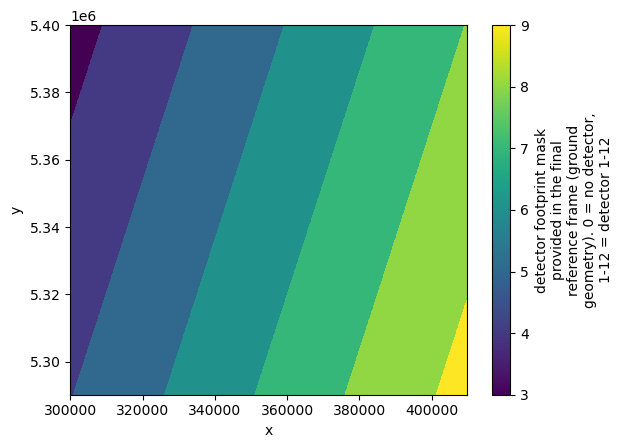

In [7]:
# Visualize detector footprint coverage at 60 m resolution (Band 09)
l1c_original["conditions"]["mask"]["detector_footprint"]["r60m"].b09.plot()

(Select)=
## Selecting a Region and Verifying Detector Consistency

Wave spectrum analysis requires high resolution data. Thus we focus our analysis on 10 m spatial resolution band, such as B04 and B02, which are available in Sentinel-2 L1C products.

A 5 km × 5 km area of interest was manually selected using the UTM grid. To ensure accurate wave spectrum computation, we verify that the selected region in both bands corresponds to the same detector.

This verification step helps ensure consistency in viewing geometry. We also visualize the selected bands to inspect reflectance values before proceeding with spectral analysis.

Let's first define the area and try to plot the area on the map

In [8]:
# Define patch size in meters
size = 5000  # in meter

# Ocean location example: (change minx to switch to land)
minx = 352_305
miny = 5_345_005

# Bounding box corners
maxx = minx + size
maxy = miny + size

# Draw UTM bounding box using HoloViews
box = hv.Rectangles([(minx, miny, maxx, maxy)]).opts(
    line_color="white", line_width=1, fill_alpha=0
)

print("Selected UTM coordinates:", minx, maxx, miny, maxy)

# Overlay selected region on RGB quicklook
l1c_plot * box

Selected UTM coordinates: 352305 357305 5345005 5350005


:DynamicMap   []
   :Overlay
      .RGB.I        :RGB   [quality_l1c_quicklook_x,quality_l1c_quicklook_y]   (R,G,B)
      .Rectangles.I :Rectangles   [x0,y0,x1,y1]

### Clipping the dataset

Let's clip the data to the boundig box defined above.

Once clipped, we name the 10 m resolution bands dataset `r10m`.

We will use this `r10m` dataset throughout the notebook.

```{tip}
**When to call `.persist()`**  

At this point, we deliberately **call `.persist()`** when creating `r10m`. This signals Dask to begin loading the data into distributed memory (**across workers**), which can significantly speed up subsequent operations.

Use `.persist()` when the clipped subset fits comfortably in memory. If the dataset exceeds available memory, avoid persisting to prevent worker exhaustion or crashes.


In [9]:
# clip out l1c with above defind mix and miny

l1c = l1c_original.sel(x=slice(minx, maxx - 1), y=slice(miny, maxy - 1, -1))
r10m = l1c["measurements"]["reflectance"]["r10m"].to_dataset()  # .persist()
# here i used persist because the data set is not very huge, so we can persist it to local dask worker.

r10m

<xarray.Dataset> Size: 8MB
Dimensions:  (y: 500, x: 500)
Coordinates:
  * x        (x) int64 4kB 352305 352315 352325 352335 ... 357275 357285 357295
  * y        (y) int64 4kB 5345005 5345015 5345025 ... 5349975 5349985 5349995
Data variables:
    b02      (y, x) float64 2MB dask.array<chunksize=(10, 260), meta=np.ndarray>
    b03      (y, x) float64 2MB dask.array<chunksize=(10, 260), meta=np.ndarray>
    b04      (y, x) float64 2MB dask.array<chunksize=(10, 260), meta=np.ndarray>
    b08      (y, x) float64 2MB dask.array<chunksize=(10, 260), meta=np.ndarray>

In [10]:
# loop over all data variables in the Dataset
plots = [
    r10m[var].hvplot(
        x="x",
        y="y",
        aspect="equal",
        rasterize=True,
        cmap="jet",
        title=f"{var}",
        frame_width=200,
    )
    for var in r10m.data_vars
]

# Layout plots horizontally
layout = plots[0]
for p in plots[1:]:
    layout += p

layout.cols(2)

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [x,y]   (TOA reflectance from MSI acquisition at spectral band b02 492.3 nm)
   .DynamicMap.II  :DynamicMap   []
      :Image   [x,y]   (TOA reflectance from MSI acquisition at spectral band b03 559.0 nm)
   .DynamicMap.III :DynamicMap   []
      :Image   [x,y]   (TOA reflectance from MSI acquisition at spectral band b04 665.0 nm)
   .DynamicMap.IV  :DynamicMap   []
      :Image   [x,y]   (TOA reflectance from MSI acquisition at spectral band b08 833.0 nm)

### Detector Consistency Verification

Sentinel-2 uses multiple detectors (1-12) with slightly different viewing geometries. For accurate wave spectral analysis, our region must come from a single detector to ensure:

- Consistent viewing angles
- Synchronized temporal sampling  
- Uniform spectral calibration

This is critical for the Fourier analysis that follows.

Lets verify if all the data we cropped are from the same detector. 

In [11]:
# verify that all information is from same detector.
b04_detector = l1c["conditions"]["mask"]["detector_footprint"]["r10m"]["b04"].astype(
    int
)

detector = np.unique(b04_detector.values)


if len(detector) > 1:
    raise ValueError(f"b04_detector is not unique! : {detector}")
else:
    detector = detector[0]
    print(f"✅ : Single detector confirmed: {detector}")

✅ : Single detector confirmed: 6


## Image Normalization and Whitecap Filtering

In this section, we extract and normalize the B04 and B02 bands from the Sentinel-2 Level-1C reflectance data, and then apply an edge-based filtering (Sobel + threshold) to reduce the influence of whitecaps (i.e., foam-related reflectance artifacts).

Band Selection

The example worked with
- B04 (red) and
- B02 (blue)
Both are available at 10 m resolution:
So lets try to use the functionality of Xarray Data set and make the operation to all the r10m band

### Median Normalization and Axis Transposition

As per the original workflow, the X and Y axes are transposed at the point it read the jpg image from SAFE file. 
We transpose it here to match image orientation in the original workflow.

In [13]:
# original notebook, b04  is indicated as img1, b02 is indicated as img2
#  x and y are inversed at the point of loading dataset. So we inverse the data
#  as in the original workflow using transpose.

# Normalize by median and transpose (Y, X -> X, Y)
normalised_r10 = r10m.apply(
    lambda da: da / np.nanmedian(da.values),
)
img_r10m = normalised_r10.transpose().persist()
img_r10m

<xarray.Dataset> Size: 8MB
Dimensions:  (x: 500, y: 500)
Coordinates:
  * x        (x) int64 4kB 352305 352315 352325 352335 ... 357275 357285 357295
  * y        (y) int64 4kB 5345005 5345015 5345025 ... 5349975 5349985 5349995
Data variables:
    b02      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>
    b03      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>
    b04      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>
    b08      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>

In [14]:
# loop over all data variables in the Dataset
plots = [
    img_r10m[var].hvplot(
        x="x",
        y="y",
        aspect="equal",
        rasterize=True,
        cmap="jet",
        clim=(0.9, 1.1),
        title=f"{var.upper()}",
        frame_width=200,
    )
    for var in img_r10m.data_vars
]

# Layout plots horizontally
layout = plots[0]
for p in plots[1:]:
    layout += p

layout.cols(2)

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [x,y]   (b02)
   .DynamicMap.II  :DynamicMap   []
      :Image   [x,y]   (b03)
   .DynamicMap.III :DynamicMap   []
      :Image   [x,y]   (b04)
   .DynamicMap.IV  :DynamicMap   []
      :Image   [x,y]   (b08)

### Sobel Filtering and Whitecap Masking

We apply the Sobel operator to all images to highlight intensity gradients (edges), typically corresponding to whitecaps or strong reflectance structures. Then, a 95th percentile threshold is used to mask out strong-gradient regions.

In [15]:
# Apply the sobel operator
gradient_sobel = img_r10m.apply(
    lambda da: sobel(da),
)
gradient_sobel = gradient_sobel.persist()
gradient_sobel

<xarray.Dataset> Size: 8MB
Dimensions:  (x: 500, y: 500)
Coordinates:
  * x        (x) int64 4kB 352305 352315 352325 352335 ... 357275 357285 357295
  * y        (y) int64 4kB 5345005 5345015 5345025 ... 5349975 5349985 5349995
Data variables:
    b02      (x, y) float64 2MB 0.02502 0.03083 0.0129 ... 0.01687 0.005291
    b03      (x, y) float64 2MB 0.02742 0.06537 0.05231 ... 0.00499 0.003059
    b04      (x, y) float64 2MB 0.02983 0.09095 0.09686 ... 0.01331 0.01881
    b08      (x, y) float64 2MB 0.07469 0.1543 0.1017 ... 0.03526 0.02452

In [16]:
# Plot Sobel gradient of each bands

plots = [
    gradient_sobel[var].hvplot(
        x="x",
        y="y",
        aspect="equal",
        rasterize=True,
        cmap="gist_gray_r",
        # clim=(0.9, 1.1),
        # flip_yaxis=True,
        colorbar=True,
        clabel="Gradient amplitude",
        title=f"Edge Detection (Sobel) - {var}-",
        frame_width=200,
    )
    for var in gradient_sobel.data_vars
]

# Layout plots horizontally
layout = plots[0]
for p in plots[1:]:
    layout += p

layout.cols(2)

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [x,y]   (b02)
   .DynamicMap.II  :DynamicMap   []
      :Image   [x,y]   (b03)
   .DynamicMap.III :DynamicMap   []
      :Image   [x,y]   (b04)
   .DynamicMap.IV  :DynamicMap   []
      :Image   [x,y]   (b08)

In [17]:
# Threshold (95th percentile)
# Binary mask: retain only low-gradient (non-whitecap) regions
mask = gradient_sobel.apply(
    lambda da: da < np.percentile(da, 95),
)

In [18]:
# Apply masks: replace high-gradient areas with NaN

filterd_r10m = (img_r10m.where(mask, np.nan)).persist()
filterd_r10m

<xarray.Dataset> Size: 8MB
Dimensions:  (x: 500, y: 500)
Coordinates:
  * x        (x) int64 4kB 352305 352315 352325 352335 ... 357275 357285 357295
  * y        (y) int64 4kB 5345005 5345015 5345025 ... 5349975 5349985 5349995
Data variables:
    b02      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>
    b03      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>
    b04      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>
    b08      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>

In [19]:
# Plot the filtered image

plots = [
    filterd_r10m[var].hvplot(
        x="x",
        y="y",
        aspect="equal",
        rasterize=True,
        cmap="viridis",
        clim=(0.9, 1.1),
        colorbar=True,
        clabel="Filtered Image",
        title=f"Filtered Image (after Sobel + Threshold) - {var}-",
        frame_width=200,
    )
    for var in filterd_r10m.data_vars
]

# Layout plots horizontally
layout = plots[0]
for p in plots[1:]:
    layout += p

layout.cols(2)

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [x,y]   (b02)
   .DynamicMap.II  :DynamicMap   []
      :Image   [x,y]   (b03)
   .DynamicMap.III :DynamicMap   []
      :Image   [x,y]   (b04)
   .DynamicMap.IV  :DynamicMap   []
      :Image   [x,y]   (b08)

### Pixel Value Distribution (Histogram)

We visualize the intensity distribution of the normalized reflectance values for bands using histograms. This step helps verify that the normalization behaves consistently across the two channels and that there are no outliers or saturation artifacts before spectral processing.

If it is a bimodial distribution, it may indicate the presense of clouds or other non wave related artifacts. 

In [20]:
# Display the histogram of values for the original image

plots = [
    img_r10m[var].hvplot.hist(
        bins=100,
        #    color='blue',
        alpha=0.3,
        xlabel="Pixel Value",
        ylabel="Frequency",
        title="Histogramme intensity of each bands",
        frame_width=400,
    )
    for var in filterd_r10m.data_vars
]
combined_reversed = plots[-1]
for p in plots[-2::-1]:
    combined_reversed = combined_reversed * p

combined_reversed

:Overlay
   .NdOverlay.I   :NdOverlay   [Variable]
      :Histogram   [b08]   (Count)
   .NdOverlay.II  :NdOverlay   [Variable]
      :Histogram   [b04]   (Count)
   .NdOverlay.III :NdOverlay   [Variable]
      :Histogram   [b03]   (Count)
   .NdOverlay.IV  :NdOverlay   [Variable]
      :Histogram   [b02]   (Count)

(Welch)=
## Fourier Transform & Welch-Based Spectral Analysis

This section demonstrates a two-dimensional Fast Fourier Transform (FFT) analysis on paired Sentinel‑2 images (e.g., bands B02 and B04). The core function, `FFT2D_two_arrays_nonan`, is adapted directly from the original research implementation and follows a Welch-style spectral estimation.

### Overview of the Processing Steps:
1. **Image Tiling**: The images are partitioned into overlapping tiles configured by `ntile`.
2. **NaN Handling**: Within each tile, any NaN values (e.g., from filtering or masking) are replaced by the local tile mean. Tiles containing more than 50 % NaNs are excluded.
3. **Windowing**: A 2D Hanning window is applied to each tile to minimize edge artifacts and spectral leakage.
4. **FFT Execution**: FFT is computed for each windowed tile, and the resulting power spectra are accumulated.
5. **Spectrum Averaging**: Averaging across all tiles (standard Welch method) enhances spectral stability and reduces noise.

### Output Metrics:
- `Eta`, `Etb`: Power spectral density (PSD) for each image
- `coh`: Spectral coherence between the two images
- `ang`: Phase difference (in radians)
- `crosr`: Real part of the cross‑spectrum
- `kx2`, `ky2`: Spatial frequency coordinates (cycles per meter)
- `dkxtile`, `dkytile`: Frequency resolution in both axes

In [21]:
def FFT2D_two_arrays_nonan(arraya, arrayb, dx, dy, n, isplot=False):
    """
    Advanced 2D Spectral Analysis using Welch's Method

    This function implements the gold standard for ocean wave spectral analysis,
    providing robust estimates of wave energy and directional characteristics.

    Parameters:
    -----------
    arraya, arrayb : 2D arrays
        Satellite image bands (e.g., B04, B02) after preprocessing
    dx, dy : float
        Pixel spacing in meters (10m for Sentinel-2 L1C)
    n : int
        Tile subdivision factor. Creates n² + (n-1)² overlapping tiles
        Higher n = better statistics, lower spatial resolution

    Key Processing Steps:
    -------------------
    1. **Overlapping Tiles**: Divides images into overlapping segments
       - Regular grid: n × n tiles
       - Offset grid: (n-1) × (n-1) tiles with 50% overlap
       - Overlap reduces edge effects and improves statistics

    2. **NaN Handling**: Replaces missing data with local tile mean
       - Skips tiles with >50% missing data
       - Preserves spectral integrity while handling clouds/land

    3. **Windowing**: Applies 2D Hanning window to each tile
       - Reduces spectral leakage from sharp tile edges
       - Essential for accurate frequency analysis

    4. **FFT Processing**: Computes 2D Fourier transform per tile
       - Forward FFT with proper normalization
       - Frequency shifting for centered spectrum

    5. **Welch Averaging**: Combines spectra from all tiles
       - Reduces noise through ensemble averaging
       - Provides robust spectral estimates

    Returns:
    --------
    Eta, Etb : 2D arrays
        Power spectral densities for input arrays
    coh : 2D array
        Spectral coherence (0=uncorrelated, 1=perfectly correlated)
    ang : 2D array
        Phase difference between arrays (wave propagation direction)
    crosr : 2D array
        Real part of cross-spectrum
    kx2, ky2 : 2D arrays
        Wavenumber coordinates (cycles/meter)

    Applications:
    ------------
    - Wave height and direction estimation
    - Surface roughness characterization
    - Current detection via Doppler shifts
    - Validation of wave models
    """

    nxa, nya = arraya.shape
    mspec = n**2 + (n - 1) ** 2
    nxtile, nytile = nxa // n, nya // n
    dkxtile = 1 / (dx * nxtile)
    dkytile = 1 / (dy * nytile)
    shx, shy = nxtile // 2, nytile // 2

    # Build kx, ky frequency axes
    kx = np.fft.fftshift(np.fft.fftfreq(nxtile, dx))
    ky = np.fft.fftshift(np.fft.fftfreq(nytile, dy))
    kx2, ky2 = np.meshgrid(kx, ky, indexing="ij")

    wx = 0.5 * (1 - np.cos(2 * np.pi * np.arange(nxtile) / (nxtile - 1)))
    wy = 0.5 * (1 - np.cos(2 * np.pi * np.arange(nytile) / (nytile - 1)))
    window2d = np.outer(wx, wy)
    norm_factor = (1 / np.mean(wx**2) * 1 / np.mean(wy**2)) / (dkxtile * dkytile)

    Eta = np.zeros((nxtile, nytile))
    Etb = np.zeros((nxtile, nytile))
    phase_acc = np.zeros((nxtile, nytile), dtype=np.complex128)
    phases = np.zeros((nxtile, nytile, mspec), dtype=np.complex128)

    nspec = 0
    for m in range(mspec):
        if m < n**2:
            i1, i2 = divmod(m, n)
            ix1, ix2 = i1 * nxtile, (i1 + 1) * nxtile - 1
            iy1, iy2 = i2 * nytile, (i2 + 1) * nytile - 1
        else:
            idx = m - n**2
            i1, i2 = divmod(idx, n - 1)
            ix1 = i1 * nxtile + shx
            iy1 = i2 * nytile + shy
            ix2 = ix1 + nxtile - 1
            iy2 = iy1 + nytile - 1

        tileA = arraya[ix1 : ix2 + 1, iy1 : iy2 + 1].astype(np.float64)
        tileB = arrayb[ix1 : ix2 + 1, iy1 : iy2 + 1].astype(np.float64)

        # Fill NaNs with tile mean
        for tile in (tileA, tileB):
            if np.isnan(tile).any():
                tile[np.isnan(tile)] = np.nanmean(tile)

        # Skip tiles with excessive NaNs
        if np.isnan(tileA).mean() > 0.5 or np.isnan(tileB).mean() > 0.5:
            continue

        FA = np.fft.fftshift(
            np.fft.fft2((tileA - tileA.mean()) * window2d, norm="forward")
        )
        FB = np.fft.fftshift(
            np.fft.fft2((tileB - tileB.mean()) * window2d, norm="forward")
        )

        Eta += np.abs(FA) ** 2 * norm_factor
        Etb += np.abs(FB) ** 2 * norm_factor
        phase_acc += FB * np.conj(FA) * norm_factor
        phases[:, :, nspec] = (FB * np.conj(FA)) / (np.abs(FA) * np.abs(FB))
        nspec += 1

    Eta /= nspec
    Etb /= nspec
    coh = np.abs(phase_acc / nspec) ** 2 / (Eta * Etb)
    ang = np.angle(phase_acc / nspec)
    crosr = np.real(phase_acc) / mspec
    angstd = np.std(np.angle(phases), axis=2)

    return Eta, Etb, ang, angstd, coh, crosr, phases, kx2, ky2, dkxtile, dkytile

    # resolution of B02, B04 is 10 m


dx = dy = 10


(nx, ny) = filterd_r10m["b02"].shape
filtered_image1 = filterd_r10m["b04"].compute().values
filtered_image2 = filterd_r10m["b02"].compute().values

ntile = 16
(Eta, Etb, ang, angstd, coh, crosr, phases, kx2, ky2, dkx, dky) = (
    FFT2D_two_arrays_nonan(filtered_image1, filtered_image2, dx, dy, ntile, isplot=0)
)

print(np.shape(Eta))
print(np.shape(kx2))
print(np.shape(ky2))

(31, 31)
(31, 31)
(31, 31)


### Computing Viewing Geometry 📐 : Sun and View Angles

We want to extract sun and viewing angles from the Sentinel-2 L1C data product and compute relevant angular quantities such as phase angles or off-specular angles. These metrics help understand the scattering geometry at the selected region (e.g., for ocean wave analysis).

#### Accessing the Angle Data  🌞 

The full datatree contains the geometry metadata at this location ['conditions']['geometry']:


In [22]:
(
    l1c_original["conditions"]["geometry"]["sun_angles"].hvplot(
        x="x",
        y="y",
        aspect="equal",
        frame_width=200,
    )
    + l1c_original["conditions"]["geometry"]["viewing_incidence_angles"].hvplot(
        x="x",
        y="y",
        aspect="equal",
        frame_width=200,
    )
).cols(1)

:Layout
   .DynamicMap.I  :DynamicMap   [angle]
      :Image   [x,y]   (sun_angles)
   .DynamicMap.II :DynamicMap   [detector,band,angle]
      :Image   [x,y]   (viewing_incidence_angles)

In [23]:
sun_angles = l1c["conditions"]["geometry"]["sun_angles"]
view_angles = l1c["conditions"]["geometry"]["viewing_incidence_angles"]
sun_angles.compute().values, view_angles.sel(
    detector=detector, band=["b02", "b04"]
).compute().values

(array([[[ 27.0145]],
 
        [[152.472 ]]]),
 array([[[[ 1.13787]],
 
         [[89.3232 ]]],
 
 
        [[[ 1.38971]],
 
         [[67.2367 ]]]]))

Since we’ve already clipped the image for our region of interest, we only extract the angles for this subset. However, the sampling grid might not be perfectly centered, so we need to interpolate the angle fields at the center of our clipped region.

✂️ Determine the Center of the Clipped Region


In [24]:
x_val = (minx + maxx) / 2
y_val = (miny + maxy) / 2
print(x_val, y_val)

354805.0 5347505.0


But in our case, it is slightly be off the center of our image.  So let's get it interpolated. 

###  Interpolating and Analyzing Viewing Geometry from Sentinel-2 L1C Data
To extract sun and viewing angles at a specific location in the scene, convert them to Cartesian unit vectors, and compute derived angular metrics for scattering geometry analysis.

 Interpolating Angles at Arbitrary `(x, y)` Coordinates

In [25]:
def interpolate_angles_at_xy(x_val, y_val, angle_array):
    """
    Interpolate azimuth and zenith angles at (x, y) coordinates.

    Parameters:
        x_val (float): x coordinate
        y_val (float): y coordinate
        angle_array (xarray.DataArray): must have 'angle' dimension with 'zenith' and 'azimuth'

    Returns:
        xarray.DataArray: Interpolated angle array with dimensions (band, detector, angle)
    """
    angle_names = angle_array.angle.values
    if "azimuth" not in angle_names or "zenith" not in angle_names:
        raise ValueError("Missing 'azimuth' or 'zenith' in angle dimension.")

    zenith = angle_array.sel(angle="zenith").interp(x=x_val, y=y_val)
    azimuth = angle_array.sel(angle="azimuth")
    sin_az = np.sin(np.deg2rad(azimuth))
    cos_az = np.cos(np.deg2rad(azimuth))
    interp_sin = sin_az.interp(x=x_val, y=y_val)
    interp_cos = cos_az.interp(x=x_val, y=y_val)
    azimuth_corrected = (np.rad2deg(np.arctan2(interp_sin, interp_cos))) % 360

    result = xr.concat(
        [
            zenith.expand_dims(angle=["zenith"]),
            azimuth_corrected.expand_dims(angle=["azimuth"]),
        ],
        dim="angle",
    )
    return result


view_angles = interpolate_angles_at_xy(
    x_val, y_val, l1c_original["conditions"]["geometry"]["viewing_incidence_angles"]
)
sun_angles = interpolate_angles_at_xy(
    x_val, y_val, l1c_original["conditions"]["geometry"]["sun_angles"]
)
sun_angles.compute().values, view_angles.sel(
    detector=detector, band=["b02", "b04"]
).compute().values

(array([ 26.99460189, 152.45104   ]),
 array([[ 1.09648737,  1.35688407],
        [88.6205506 , 65.99286503]]))

###  Computes angular metrics comparable to the original Sentinel‑2 SAFE/SAFE2 XML‑based code, using Zarr format and xarray:

1.	Spherical to Cartesian Conversion
Convert interpolated zenith and azimuth angles (sun and view) into unit vectors:
sunvec = sph2cart(sun_angles) and obsvec = sph2cart(view_angles).

2.	Mid-Vector Calculation
Sum and normalize the two direction vectors to obtain the mid-vector (midvec_norm) between sensor and sun hemispheres.

3.	Derived Metrics
Compute three angular metrics essential for scattering analysis:
    - offspec: Off‑specular angle = angle between mid‑vector and vertical
    - phitrig: Azimuth of mid‑vector (used to overlay blind azimuths on k‑space)
    - thetav: Sensor view zenith angle
    
4.	Selection for Specific Band & Detector
Choose the relevant subset for a given detector and bands (e.g. B04 and B02):


In [26]:
def sph2cart(angle_da):
    """
    Convert spherical angles to Cartesian unit vectors.

    Parameters:
        angle_da (xarray.DataArray): must have 'angle' = ['zenith', 'azimuth']

    Returns:
        xarray.DataArray: shape (..., cartesian) with cartesian = ['x', 'y', 'z']
    """
    theta = np.radians(angle_da.sel(angle="zenith"))
    phi = np.radians(angle_da.sel(angle="azimuth"))
    x = np.sin(theta) * np.sin(phi)
    y = np.sin(theta) * np.cos(phi)
    z = np.cos(theta)
    return xr.concat([x, y, z], dim="cartesian").assign_coords(
        cartesian=["x", "y", "z"]
    )


# Compute Cartesian vectors
sunvec = sph2cart(sun_angles)
obsvec = sph2cart(view_angles)
# 🔄 Mid-Vector and Normalization
midvec = obsvec + sunvec
midvec_norm = midvec / np.sqrt((midvec**2).sum("cartesian"))
# 📐 Angular Metrics Computation
offspec = np.degrees(np.arccos(midvec_norm.sel(cartesian="z")))
phitrig = np.degrees(
    np.arctan2(midvec_norm.sel(cartesian="x"), midvec_norm.sel(cartesian="y"))
)
thetav = np.degrees(np.arccos(obsvec.sel(cartesian="z")))
phitrig = phitrig.sel(detector=6, band=["b04", "b02"]).compute()
phitrig

<xarray.DataArray (band: 2)> Size: 16B
array([149.47993192, 150.32367791])
Coordinates:
  * band      (band) <U3 24B 'b04' 'b02'
    detector  int64 8B 6
    x         float64 8B 3.548e+05
    y         float64 8B 5.348e+06
    angle     <U6 24B 'zenith'

### Blind Azimuth Vectors in Fourier Space

This section overlays directional markers in Fourier space (**k‑space**) to emphasize **blind azimuth angles**—directions in which specular reflection (sunglint) is minimized. These are useful for interpreting wave fields in optical imagery, especially when bright reflections mask fine patterns.

Waves propagating along these **blind directions** are expected to produce minimal brightness modulation due to the geometry of sun-sensor alignment, making them harder to detect.

To compute and overlay these directions:

- **`phitrig[b]`** is the azimuth angle (in degrees) of the **mid-vector** between the sun and sensor directions, previously computed for each band *b*.
- The **blind azimuth direction** is calculated as:
  ```python
  phiblind = phitrig + 90
   ```
  This is orthogonal to the mid-vector, i.e., the direction where sunglint is minimized.
- k-space overlay vectors are then defined as:
  ```python
  ±1.4 * kN * [sin(phiblind), cos(phiblind)]  
  ```
  where:
  - kN = 50 is a manual scaling factor to make the vectors visually prominent in spectral plots.
  - The ± sign draws symmetric vectors in both directions.

These vectors are plotted as dashed lines on 2D spectral maps (e.g., power, coherence, phase) to visualize and assess whether wave energy aligns with or avoids these blind azimuth directions.

This visualization is especially helpful to confirm directional biases in wave energy related to illumination and viewing geometry.


In [27]:
# Double check here with Nico to see if it is right to take philblind1 & 2
phiblind1 = phitrig[0].values + 90.0  # blind azimuth for B04
phiblind2 = phitrig[1].values + 90.0  # blind azimuth for B02
kN = 50
xkblind = [
    -1.4 * kN * np.sin(np.radians(phiblind1)),
    1.4 * kN * np.sin(np.radians(phiblind2)),
]
ykblind = [
    -1.4 * kN * np.cos(np.radians(phiblind1)),
    1.4 * kN * np.cos(np.radians(phiblind2)),
]
print(xkblind, ykblind)

[60.30159381316901, -60.81853346026498] [35.54880846936472, -34.65697603286573]


(Cross)=
## 🌊 Fourier and Cross-Spectral Analysis with angular metrics.

Next part visualizes and analyzes spatial and spectral properties of satellite image data, particularly from optical bands such as Sentinel-2 B02 and B04. The key steps and their explanations are outlined below.

---

### 1. 📐 Coordinate Generation

```python
X = np.arange(0, nx*dx, dx)
Y = np.arange(0, ny*dy, dy)
```

- `X` and `Y` represent the physical grid (in meters) corresponding to pixel spacing `dx` and `dy`.
- They define the spatial extent for plotting.

---

### 2. 🖼️ Surface Image Plot

```python
axs[0].pcolormesh(X/1000, Y/1000, np.transpose(filtered_image1), cmap='seismic', ...)
```

- Displays the filtered satellite image ( band B04).
- Coordinates are converted to kilometers.
- `np.transpose` is used because NumPy arrays are (row, col) = (y, x), while `pcolormesh` expects (x, y).

---

### 3. 📊 Spectrum Plot

```python
axs[1].pcolormesh(kx2*1000, ky2*1000, 10*np.log10(Eta), ...)
```

- Shows the 2D Fourier spectrum of the image.
- `kx2`, `ky2` are spatial frequency axes (cycles/km).
- The spectrum is converted to dB scale.
- Black dashed lines (`xkblind`, `ykblind`) indicate blind directions or masked regions.

---

### 4. 🧮 Variance and Energy Check

```python
print(np.var(img1), np.sum(Eta)*dkx*dky)
```

- Compares spatial domain variance to spectral energy.
- A consistency check based on Parseval's theorem.

---

### 5. 🔗 Coherence Between Bands

```python
axs[0].pcolormesh(kx2*1000, ky2*1000, coh, ...)
```

- Coherence indicates phase similarity between two bands (e.g., B02 and B04).
- Values range from 0 (incoherent) to 1 (perfectly coherent).

---

### 6. 🔄 Cross-Spectrum Phase

```python
axs[1].pcolormesh(kx2*1000, ky2*1000, np.degrees(ang), ...)
```

- Displays the phase angle of the cross-spectrum between two bands.
- Indicates relative shifts between features in different spectral bands.


In [28]:
# Turn the xarray object to numpy object, to just re-use the original python code using SAFE format

img1 = r10m["b04"].compute().values
img2 = r10m["b02"].compute().values
np.var(img1.flatten())

1.0522288165696002e-05

variance 1: 1.0522288165696002e-05 sum of spectrum: 0.003969145049406069
variance 2: 6.352549202547042e-06 sum of spectrum: 0.0005955796139226746


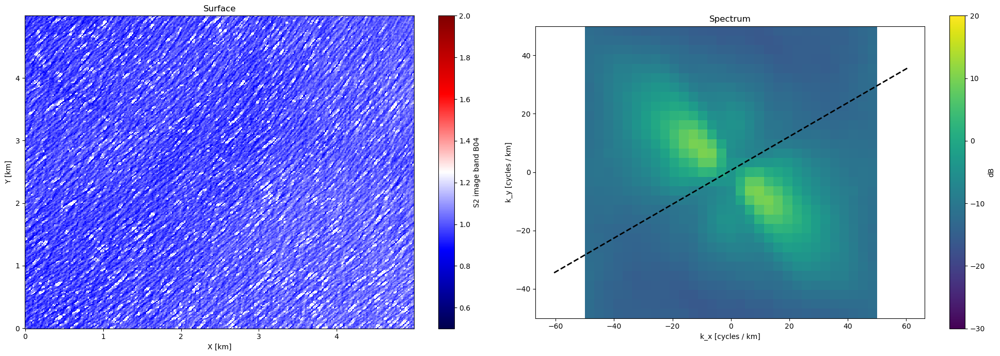

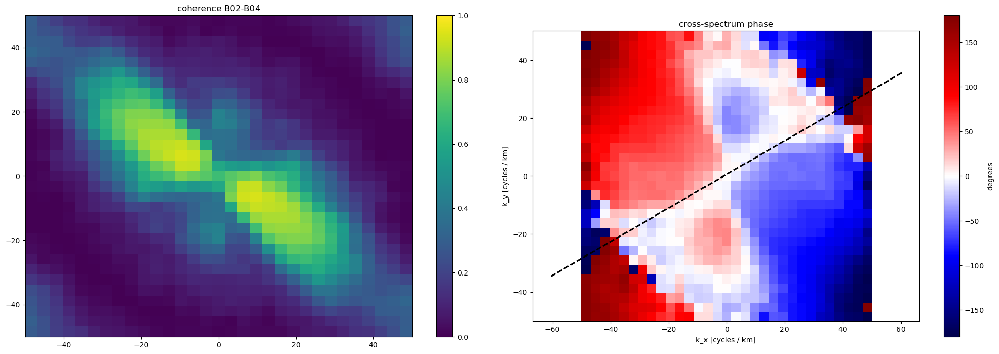

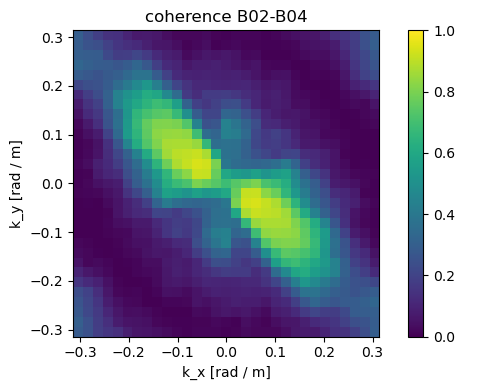

In [29]:
X = np.arange(0, nx * dx, dx)  # from 0 to (nx-1)*dx with a dx step
Y = np.arange(0, ny * dy, dy)

fig, axs = plt.subplots(1, 2, figsize=(20, 7))  # ,sharey=True,sharex=True)
_ = plt.gca().set_aspect("equal", adjustable="box")

# warning: we use an array img1 that is written with X in the first (number 0) dimension and Y in the second
#          but pcolormesh uses the opposite order: hence the use of transpose

im = axs[0].pcolormesh(
    X / 1000,
    Y / 1000,
    np.transpose(filtered_image1),
    cmap="seismic",
    norm=mcolors.Normalize(vmin=0.5, vmax=2),
)
_ = plt.colorbar(im, ax=axs[0], label="S2 image band B04")
_ = axs[0].set_xlabel("X [km]")
_ = axs[0].set_ylabel("Y [km]")
_ = axs[0].set_title("Surface")

im = axs[1].pcolormesh(
    kx2 * 1000,
    ky2 * 1000,
    10 * np.log10((Eta)),
    norm=mcolors.Normalize(vmin=-30, vmax=20),
)
_ = plt.colorbar(im, ax=axs[1], label="dB")
_ = plt.plot(xkblind, ykblind, color="k", linestyle="--", linewidth=2)
_ = axs[1].set_xlabel("k_x [cycles / km]")
_ = axs[1].set_ylabel("k_y [cycles / km]")
_ = axs[1].set_title("Spectrum")
_ = plt.tight_layout()

print(
    "variance 1:",
    np.var(img1.flatten()),
    "sum of spectrum:",
    np.sum(Eta.flatten()) * dkx * dky,
)
print(
    "variance 2:",
    np.var(img2.flatten()),
    "sum of spectrum:",
    np.sum(Etb.flatten()) * dkx * dky,
)


fig, axs = plt.subplots(1, 2, figsize=(20, 7))  # ,sharey=True,sharex=True)
_ = plt.gca().set_aspect("equal", adjustable="box")

im = axs[0].pcolormesh(
    kx2 * 1000, ky2 * 1000, coh, norm=mcolors.Normalize(vmin=0, vmax=1)
)
_ = plt.colorbar(im, ax=axs[0], label=" ")
_ = plt.plot(xkblind, ykblind, color="k", linestyle="--", linewidth=2)
_ = axs[1].set_xlabel("k_x [cycles / km]")
_ = axs[1].set_ylabel("k_y [cycles / km]")
_ = axs[0].set_title("coherence B02-B04")

im = axs[1].pcolormesh(
    kx2 * 1000,
    ky2 * 1000,
    np.degrees(ang),
    cmap="seismic",
    norm=mcolors.Normalize(vmin=-180, vmax=180),
)
_ = plt.colorbar(im, ax=axs[1], label="degrees")
_ = plt.plot(xkblind, ykblind, color="k", linestyle="--", linewidth=2)
_ = axs[1].set_xlabel("k_x [cycles / km]")
_ = axs[1].set_ylabel("k_y [cycles / km]")
_ = axs[1].set_title("cross-spectrum phase")
_ = plt.tight_layout()


fig, ax = plt.subplots(figsize=(6, 4))
ax.set_aspect("equal", adjustable="box")

im = ax.pcolormesh(
    kx2 * 2 * np.pi, ky2 * 2 * np.pi, coh, norm=mcolors.Normalize(vmin=0, vmax=1)
)
plt.colorbar(im, ax=ax, label=" ")
ax.set_xlabel("k_x [rad / m]")
ax.set_ylabel("k_y [rad / m]")
ax.set_title("coherence B02-B04")
plt.tight_layout()

## Physical Interpretation of Results

The spectral analysis reveals important oceanographic patterns that demonstrate the effectiveness of using Sentinel-2 data for wave characterization within the EOPF framework.

### Surface Image (Top Left)
- **What we see**: Filtered Sentinel-2 B04 reflectance showing ocean wave patterns
- **Preprocessing**: Whitecaps removed, median normalized, edge effects minimized
- **Scale**: 5×5 km region with 10m pixel resolution
- **Pattern**: Clear wave trains visible as brightness variations

### Power Spectrum (Top Right)  
- **What we see**: 2D Fourier transform revealing dominant wave directions
- **Axes**: Spatial frequency (cycles/km) in X and Y directions
- **Interpretation**: 
  - Bright regions = dominant wave energy
  - Peak locations = wavelength and direction
  - Dashed line = satellite viewing geometry (blind direction)
- **Key Finding**: Energy concentrated in NW-SE direction, indicating swell propagation

### Coherence Map (Bottom Left)
- **What we see**: Correlation between B02 and B04 bands in frequency space
- **Values**: 0 (random noise) to 1 (perfect correlation)
- **Interpretation**:
  - High coherence (yellow) = real wave signals
  - Low coherence (blue) = instrumental noise or artifacts
- **Quality Metric**: Coherence >0.7 indicates reliable wave measurements

### Phase Difference (Bottom Right)
- **What we see**: Time lag between B02 and B04 acquisitions
- **Physical Meaning**: Wave propagation direction and speed
- **Color Scale**: ±180 degrees phase difference
- **Key Insight**: 
  - Positive phase (red) in NW quadrant
  - Negative phase (blue) in SE quadrant
  - Indicates waves moving from NW to SE during 1-second B02-B04 delay

### Scientific Significance

This analysis reveals:

1. **Wave Direction**: NW-SE propagation consistent with Atlantic swell patterns
2. **Wave Quality**: High coherence confirms reliable measurements using EOPF datasets
3. **Propagation Speed**: Phase gradient indicates ~15-20 m/s wave celerity
4. **Methodology Validation**: Results consistent with expected oceanographic conditions in the Bay of Biscay

```{note}
The coherence values above 0.7 in specific frequency bands indicate that the EOPF ZARR workflow successfully preserves the signal quality needed for quantitative wave analysis.

(Summary)=
## Summary 
This script performs comprehensive spectral analysis of satellite imagery by:

- Visualizing filtered spatial data
- Computing 2D Fourier spectra
- Quantifying inter-band similarity via coherence and cross-spectral phase
- Evaluating energy consistency between spatial and spectral domains

It is especially useful in oceanographic but also  Earth surface pattern studies (e.g., wave fields, vegetation patterns, surface roughness).

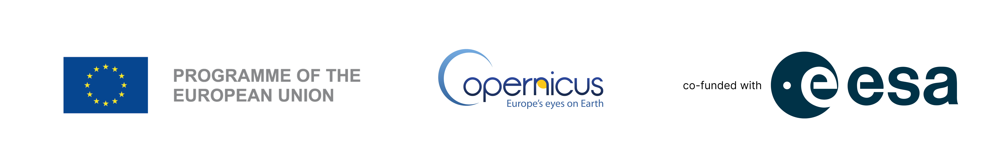